<a href="https://colab.research.google.com/github/shay-dan/DS_workshop_OpenUIL/blob/main/Weight_estimation_SAM_masks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#9.Segment Anything Model and Masks

We will now use SAM -  with our bboxes we got from detectron2 and YOLOv8 as inputs. Inforamation about SAM can be found on chapter 6 - presentation of the models.

### preprocess

In [ ]:
import torch
import torchvision
print("PyTorch version:", torch.__version__)
print("Torchvision version:", torchvision.__version__)
print("CUDA is available:", torch.cuda.is_available())
import sys
!{sys.executable} -m pip install opencv-python matplotlib
!{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

import numpy as np
import matplotlib.pyplot as plt
import cv2

PyTorch version: 2.1.0+cu121
Torchvision version: 0.16.0+cu121
CUDA is available: True
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-ttwifvsw
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-ttwifvsw
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36587 sha256=f6619629b341621d88ca726032f44e0171467dbbab24f629589963539ea794be
  Stored in directory: /tmp/pip-ephem-wheel-cache-a6mo13o5/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
--2024-02-19 13:05:24--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.35.7.50, 13.35.7.128, 13.35

In [ ]:
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

Sam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 1280, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-31): 32 x Block(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        )
        (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (lin1): Linear(in_features=1280, out_features=5120, bias=True)
          (lin2): Linear(in_features=5120, out_features=1280, bias=True)
          (act): GELU(approximate='none')
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(1280, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d

In [ ]:
from segment_anything.utils.transforms import ResizeLongestSide
resize_transform = ResizeLongestSide(sam.image_encoder.img_size)

def prepare_image(image, transform, device):
    image = transform.apply_image(image)
    image = torch.as_tensor(image, device=device.device)
    return image.permute(2, 0, 1).contiguous()

### get masks

In [ ]:
def convert_coco_to_voc(bbox):
  res = []
  for box in bbox:
    res.append(coco_to_voc(box))
  return res

In [ ]:
def coco_to_voc(coco_bbox):
    x, y, width, height = coco_bbox
    xmin = x
    ymin = y
    xmax = x + width
    ymax = y + height
    voc_bbox = [xmin, ymin, xmax, ymax]
    return voc_bbox

In [ ]:
def bgr_to_rgb(img):
  img = cv2.imread(img)
  return cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

In [ ]:
def create_tensor(bbox,box_num):
  if box_num == 3:
    return torch.tensor([bbox[0],bbox[1],bbox[2],], device=sam.device)
  return torch.tensor([bbox[0],bbox[1],], device=sam.device)

In [ ]:
import json
import csv

def get_mask(img_s,img_t,path_to_csv):
  img_s_boxes = get_bbox(img_s,path_to_csv)
  img_t_boxes = get_bbox(img_t,path_to_csv)

  sam_bbox_s = convert_coco_to_voc(img_s_boxes)
  sam_bbox_t = convert_coco_to_voc(img_t_boxes)

  s = bgr_to_rgb(img_s)
  t = bgr_to_rgb(img_t)

  num_of_objects_in_img = 2
  if "mix" in img_s:
    num_of_objects_in_img = 3

  image11_boxes = create_tensor(sam_bbox_s,num_of_objects_in_img)
  image22_boxes = create_tensor(sam_bbox_t,num_of_objects_in_img)

  batched_input = [
      {
          'image': prepare_image(s, resize_transform, sam),
          'boxes': resize_transform.apply_boxes_torch(image11_boxes, s.shape[:2]),
          'original_size': s.shape[:2]
      },
      {
          'image': prepare_image(t, resize_transform, sam),
          'boxes': resize_transform.apply_boxes_torch(image22_boxes, t.shape[:2]),
          'original_size': t.shape[:2]
      }
  ]
  batched_output = sam(batched_input, multimask_output=False)

  left_masks = []
  right_masks = []

  for mask in batched_output[0]['masks']:
      left_masks.append((mask!=False).sum())

  for mask in batched_output[1]['masks']:
      right_masks.append((mask!=False).sum())

  return left_masks,right_masks

### display mask

In [ ]:
# use for mask image display

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

In [ ]:
import json
import csv

def get_mask_and_display(img_s,img_t,path_to_csv):
  img_s_boxes = get_bbox(img_s,path_to_csv)
  img_t_boxes = get_bbox(img_t,path_to_csv)

  sam_bbox_s = convert_coco_to_voc(img_s_boxes)
  sam_bbox_t = convert_coco_to_voc(img_t_boxes)

  s = bgr_to_rgb(img_s)
  t = bgr_to_rgb(img_t)

  num_of_objects_in_img = 2
  if "mix" in img_s:
    num_of_objects_in_img = 3

  image11_boxes = create_tensor(sam_bbox_s,num_of_objects_in_img)
  image22_boxes = create_tensor(sam_bbox_t,num_of_objects_in_img)

  batched_input = [
      {
          'image': prepare_image(s, resize_transform, sam),
          'boxes': resize_transform.apply_boxes_torch(image11_boxes, s.shape[:2]),
          'original_size': s.shape[:2]
      },
      {
          'image': prepare_image(t, resize_transform, sam),
          'boxes': resize_transform.apply_boxes_torch(image22_boxes, t.shape[:2]),
          'original_size': t.shape[:2]
      }
  ]
  batched_output = sam(batched_input, multimask_output=False)
  fig, ax = plt.subplots(1, 2, figsize=(20, 20))
  left_masks = []
  right_masks = []

  ax[0].imshow(s)
  for mask in batched_output[0]['masks']:
      left_masks.append((mask!=False).sum())
      show_mask(mask.cpu().numpy(), ax[0], random_color=True)
  for box in image11_boxes:
      show_box(box.cpu().numpy(), ax[0])
  ax[0].axis('off')

  ax[1].imshow(t)
  for mask in batched_output[1]['masks']:
      right_masks.append((mask!=False).sum())
      show_mask(mask.cpu().numpy(), ax[1], random_color=True)
  for box in image22_boxes:
      show_box(box.cpu().numpy(), ax[1])
  ax[1].axis('off')

  print(left_masks)
  print(right_masks)
  plt.tight_layout()
  plt.show()
  return left_masks,right_masks

[tensor(32414, device='cuda:0'), tensor(16822, device='cuda:0'), tensor(3375, device='cuda:0')]
[tensor(13927, device='cuda:0'), tensor(27168, device='cuda:0'), tensor(2313, device='cuda:0')]


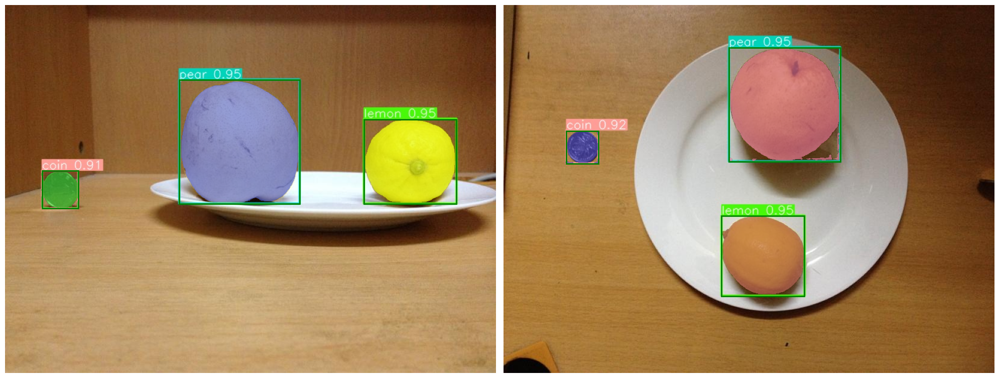

[tensor(39418, device='cuda:0'), tensor(4325, device='cuda:0')]
[tensor(43678, device='cuda:0'), tensor(2733, device='cuda:0')]


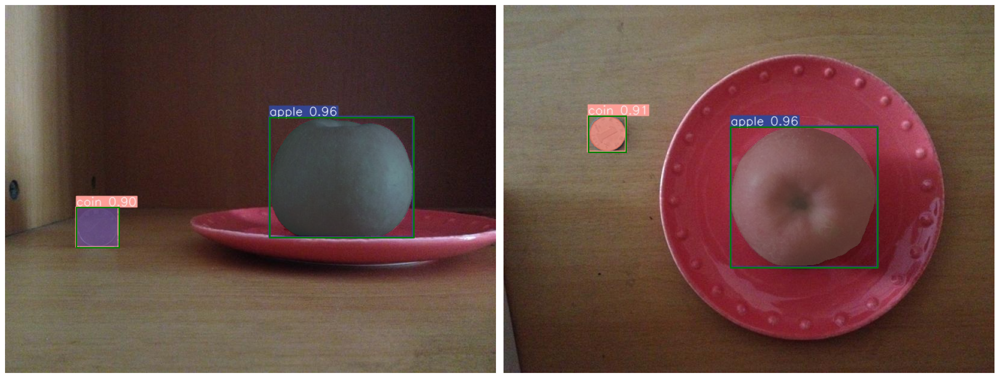

[tensor(28815, device='cuda:0'), tensor(3710, device='cuda:0')]
[tensor(35417, device='cuda:0'), tensor(1358, device='cuda:0')]


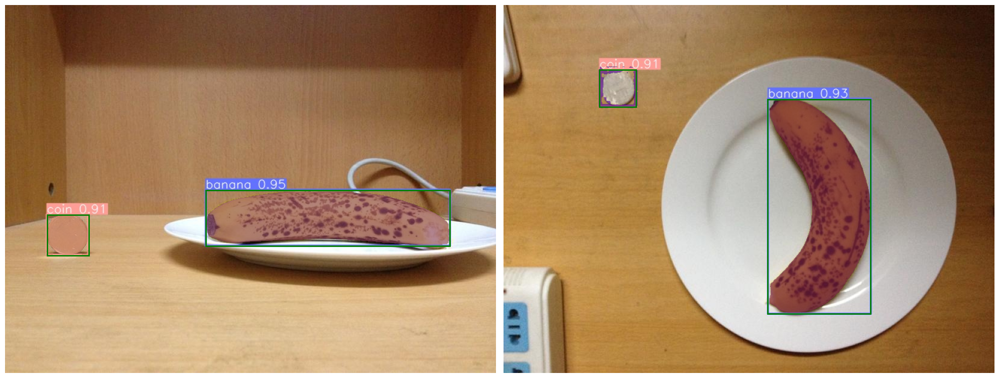

[tensor(19265, device='cuda:0'), tensor(4199, device='cuda:0')]
[tensor(46832, device='cuda:0'), tensor(2973, device='cuda:0')]


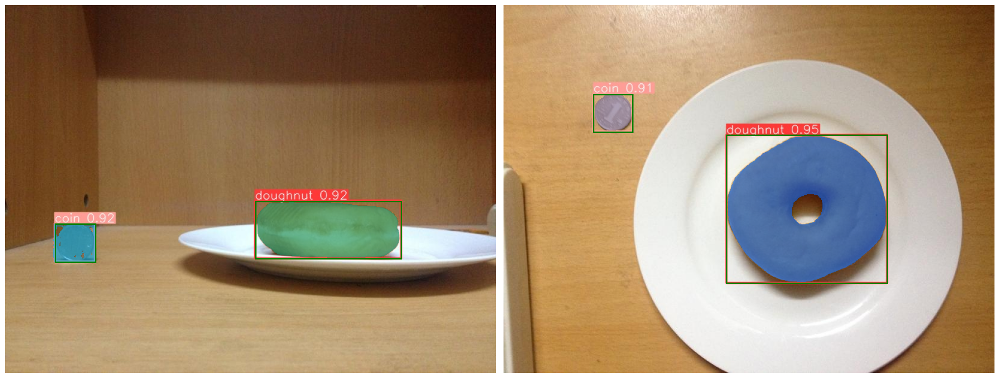

([tensor(19265, device='cuda:0'), tensor(4199, device='cuda:0')],
 [tensor(46832, device='cuda:0'), tensor(2973, device='cuda:0')])

In [ ]:
img_s = pairs[59][0]
img_t = pairs[59][1]
side_masks,top_masks = get_mask_and_display(img_s,img_t,path_to_csv)
img_s = pairs[3][0]
img_t = pairs[3][1]
get_mask_and_display(img_s,img_t,path_to_csv)
img_s = pairs[8][0]
img_t = pairs[8][1]
get_mask_and_display(img_s,img_t,path_to_csv)
img_s = pairs[21][0]
img_t = pairs[21][1]
get_mask_and_display(img_s,img_t,path_to_csv)

### create csv file

In [ ]:
yolo_csv = "/content/drive/MyDrive/test_imgs_res/output_objects_yolo.csv"
detectron_csv = "/content/drive/MyDrive/test_results_aug/output_objects.csv"

In [ ]:
import csv
def write_to_csv(file_path, names, values):
    with open(file_path, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['Name', 'Value'])  # Writing header row

        for name, value in zip(names, values):
            writer.writerow([name, value])

In [ ]:
def calc_all_masks_area(bbox_csv):
# initialize names and area for sam pred
  names = []
  areas = []
  for i in range(len(pairs)):
    left_masks,right_masks = get_mask(pairs[i][0],pairs[i][1],path_to_csv)
    names.append(pairs[i][0])
    names.append(pairs[i][1])
    areas.append(left_masks)
    areas.append(right_masks)
  # create csv file for areas from mask
  return names,areas

In [ ]:
yolo_names,yolo_areas = calc_all_masks_area(yolo_csv)

In [ ]:
csv_file_path = '/content/drive/MyDrive/sam/yolo.csv'
write_to_csv(csv_file_path, yolo_names, yolo_areas)

In [ ]:
detectron_names,detectron_areas = calc_all_masks_area(detectron_csv)

In [ ]:
csv_file_path = '/content/drive/MyDrive/sam/detectron.csv'
write_to_csv(csv_file_path, detectron_names, detectron_areas)

### calc weight

In [ ]:
import math
coin_area_in_mm = coin_radius_in_mm **2 * math.pi

In [ ]:
def get_area_from_csv(csv_file, target_name):
    with open(csv_file, 'r', newline='') as file:
        reader = csv.DictReader(file)
        for row in reader:
            if extract_info_from_path(row['Name']) == extract_info_from_path(target_name):
                return row['Value']
    # If the target_name is not found, return None
    return None

In [ ]:
def organize_area(img,csv_file_path):
  areas = get_area_from_csv(csv_file_path,img)
  areas = areas.split("tensor")[1:]
  return [extract_area(area) for area in areas]

In [ ]:
def extract_area(tensor_input):
  st = 0
  flag = 0
  for i in range(len(tensor_input)):
    if tensor_input[i].isdigit() and flag == 0:
      st = i
      flag = 1
    if not tensor_input[i].isdigit() and flag == 1:
      return int(tensor_input[st:i])

In [ ]:
csv_file_path = '/content/drive/MyDrive/sam/yolo.csv'
target_name = pairs[58][0]
organize_area(target_name,csv_file_path)

[21598, 12190, 4018]

In [ ]:
def get_area_per_obj(cls,area):
  res = []
  for c,a in zip(cls,area):
    res.append([c,a])
  return res

In [ ]:
def merge_lists(side, top):
    merged_dict = {}

    # Merge the values from the first list
    for item in side:
        key, value = item
        if key in merged_dict:
            merged_dict[key].append(value)
        else:
            merged_dict[key] = [value]

    # Merge the values from the second list
    for item in top:
        key, value = item
        if key in merged_dict:
            merged_dict[key].append(value)
        else:
            merged_dict[key] = [None, value]

    # Create the final output list
    output_list = [[key] + values for key, values in merged_dict.items()]

    return output_list

In [ ]:
path_to_csv = yolo_csv
csv_file_path = '/content/drive/MyDrive/sam/yolo.csv'
def organize_cls_and_area(pair):
  side_cls = get_cls(pair[0],path_to_csv)
  top_cls = get_cls(pair[1],path_to_csv)
  common_elements = set(side_cls) & set(top_cls)
  side_cls[:] = [elem for elem in side_cls if elem in common_elements]
  top_cls[:] = [elem for elem in top_cls if elem in common_elements]
  side_area = organize_area(pair[0],csv_file_path)
  top_area = organize_area(pair[1],csv_file_path)
  s = get_area_per_obj(side_cls,side_area)
  t = get_area_per_obj(top_cls,top_area)
  return merge_lists(s,t)

organize_cls_and_area(pairs[58])

[['tomato', 21598, 36929], ['lemon', 12190, 18233], ['coin', 4018, 3798]]

In [ ]:
def calc_ratio_from_mask(coin_area):
  return coin_area_in_mm / coin_area

In [ ]:
def get_volume_from_mask(area_side,area_top,ratio_s,ratio_t):
  side = area_side * ratio_s
  top = area_top * ratio_t
  return (side * top)**(3/4) # mm^3

In [ ]:
def get_volume_from_for_all_objs_in_plate_with_mask(pair):
  obj_and_area_list = organize_cls_and_area(pair)
  # calc pixel per mm ratio based on the yuan coin dimensions
  coin_area = []
  for obj in obj_and_area_list:
    if obj[0] == "coin":
      # bbox_s
      coin_area.append(obj[1])
      # bbox_t
      coin_area.append(obj[2])
  ratio_s = calc_ratio_from_mask(coin_area[0])
  ratio_t = calc_ratio_from_mask(coin_area[1])
  # Remove sublists containing 'coin'
  obj_and_area_list = [sublist for sublist in obj_and_area_list if sublist[0] != 'coin']
  volume = []
  # print(obj_and_area_list)
  for cls,area_s,area_t in obj_and_area_list:
    volume.append([cls,get_volume_from_mask(area_s,area_t,ratio_s,ratio_t)])
  return volume

get_volume_from_for_all_objs_in_plate_with_mask(pairs[58])

[['tomato', 211405.84555140176], ['lemon', 81082.57951678634]]

In [ ]:
def get_weight_from_mask(pair):
  volume_list = get_volume_from_for_all_objs_in_plate_with_mask(pair)
  weight_list = []
  for cls,volume in volume_list:
    weight = volume * objects[cls][1]
    weight_list.append([cls,weight])
  return weight_list

get_weight_from_mask(pairs[58])

[['tomato', 207177.7286403737], ['lemon', 77839.27633611488]]

### increase weight estimation accuracy

In [ ]:
pair = pairs[0]
img = pair[0]
pred_v = get_volume_from_for_all_objs_in_plate_with_mask(pair)
print(f"predict volume is {pred_v}")
print(f"real volume is {get_real_v(img)}")

predict volume is [['apple', 289880.7991757101]]
real volume is ['apple', 330]


create constant for accuracy

In [ ]:
constant_num = 330 / 289880.7991757101
def get_volume_from_mask(area_side,area_top,ratio_s,ratio_t):
  side = area_side * ratio_s
  top = area_top * ratio_t
  return (side * top)**(3/4) * constant_num # mm^3

In [ ]:
pair = pairs[15]
img = pair[0]
pred_v = get_volume_from_for_all_objs_in_plate_with_mask(pair)
print(f"predict volume is {pred_v}")
print(f"real volume is {get_real_v(img)}")

predict volume is [['bun', 219.75180045718486]]
real volume is ['bun', 230]


### accuracy check yolo

In [ ]:
import random
def check_accuracy_mask():
  rnd = random.randint(0, 100)
  pair = pairs[rnd]
  img_s = pair[0]
  img_t = pair[1]

  pred_v = get_volume_from_for_all_objs_in_plate_with_mask(pair)
  pred_w = get_weight_from_mask(pair)
  real_v = get_real_v(img_s)
  real_w = get_real_w(img_s)

  # adapt for only 1 obj in image
  if len(pred_v) == 1:
    real_v = [real_v]
    real_w = [real_w]

  pred_v = sorted(pred_v, key=lambda x: x[0])
  pred_w = sorted(pred_w, key=lambda x: x[0])
  real_v = sorted(real_v, key=lambda x: x[0])
  real_w = sorted(real_w, key=lambda x: x[0])

  print("-------images-------")
  print(img_s)
  print(img_t,"\n")

  for p_v,p_w,v,w in zip (pred_v,pred_w,real_v,real_w):
    print("-------predict-------")
    print(f"{p_v[0]} predict volume is {p_v[1]} mm^3")
    print(f"{p_w[0]} predict weight is {p_w[1]} g\n")
    print("-------real-------:")
    print(f"{v[0]} real volume is {v[1]} mm^3")
    print(f"{w[0]} real weight is {w[1]} g\n")

  print("-------error-------")
  print(f"volume error is {calc_error(pred_v,real_v)} %")
  print(f"weight error is {calc_error(pred_w,real_w)} %")
  print()

In [ ]:
check_accuracy_mask()
check_accuracy_mask()

-------images-------
/content/drive/MyDrive/test_imgs_res/mix010S(6).JPG-YOLOv8-result.JPG
/content/drive/MyDrive/test_imgs_res/mix010T(6).JPG-YOLOv8-result.JPG 

-------predict-------
lemon predict volume is 92.30432411054824 mm^3
lemon predict weight is 88.61215114612631 g

-------real-------:
lemon real volume is 100 mm^3
lemon real weight is 97.5 g

-------predict-------
tomato predict volume is 240.66419449076872 mm^3
tomato predict weight is 235.85091060095334 g

-------real-------:
tomato real volume is 180 mm^3
tomato real weight is 186.4 g

-------error-------
volume error is 20.699003081050527 %
weight error is 17.822600445567858 %

-------images-------
/content/drive/MyDrive/test_imgs_res/peach004S(3).JPG-YOLOv8-result.JPG
/content/drive/MyDrive/test_imgs_res/peach004T(3).JPG-YOLOv8-result.JPG 

-------predict-------
peach predict volume is 99.57145500175368 mm^3
peach predict weight is 101.56288410178875 g

-------real-------:
peach real volume is 90 mm^3
peach real weight 

In [ ]:
def get_accuracy_in_one_pair_mask(pair_index):

  pair = pairs[pair_index]
  img_s = pair[0]
  img_t = pair[1]

  pred_v = get_volume_from_for_all_objs_in_plate_with_mask(pair)
  pred_w = get_weight_from_mask(pair)
  real_v = get_real_v(img_s)
  real_w = get_real_w(img_s)

  # mix or one object
  flag = "mix"
  # adapt for only 1 obj in image
  if len(pred_w) == 1:
    real_w = [real_w]
    flag = "one object"

  pred_w = sorted(pred_w, key=lambda x: x[0])
  real_w = sorted(real_w, key=lambda x: x[0])
  if flag == "one object":
    return [pred_w[0][0],calc_error(pred_w,real_w)]
  return ["mix",calc_error(pred_w,real_w)]

def get_accuracy_in_all_dataset_mask():
  error_list = []
  for i in range(len(pairs)):
    error_list.append(get_accuracy_in_one_pair_mask(i))

  # convert to dictationary
  result_dict = {}
  for item in error_list:
    key, value = item[0], item[1]

    if key in result_dict:
        result_dict[key].append(value)
    else:
        result_dict[key] = [value]

  # save only the mean error per class
  sum_of_all_values = 0
  for key, values in result_dict.items():
    result_dict[key] = sum(values) / len(values)
    sum_of_all_values += sum(values)

  # Calculate mean error for all values
  # Add "error of the data test" to the result_dict
  result_dict["error of the data test"] = sum_of_all_values / len(pairs)

  return result_dict

get_accuracy_in_all_dataset_mask()

{'apple': 6.765247461789644,
 'banana': 47.99771973693393,
 'bread': 127.85391337294632,
 'bun': 29.378288621244707,
 'doughnut': 26.7472410635022,
 'egg': 49.35073420724906,
 'fired_dough_twist': 97.99143039473272,
 'grape': 208.47701910095915,
 'lemon': 12.880126458720977,
 'litchi': 36.400621270504836,
 'mango': 18.04658466875292,
 'mix': 13.200795968451512,
 'mooncake': 19.48572927222403,
 'orange': 20.689909810093344,
 'peach': 12.198595615449623,
 'pear': 6.907399992828021,
 'plum': 18.067658192809365,
 'qiwi': 24.94254110014966,
 'sachima': 11.55788752115231,
 'tomato': 13.705937401002382,
 'error of the data test': 40.13226906157484}

In [ ]:
def error_summary_mask():
  input_dict = get_accuracy_in_all_dataset_mask()
  # Find key with highest value
  max_key = max(input_dict, key=input_dict.get)
  max_value = input_dict[max_key]

  # Find key with lowest value
  min_key = min(input_dict, key=input_dict.get)
  min_value = input_dict[min_key]

  # Print results
  print("Highest error:", max_key)
  print("Value:", max_value,"%")
  print("\nLowest error:", min_key)
  print("Value:", min_value,"%")
  print("\nMean error:")
  print("Value", ":", list(input_dict.values())[-1],"%")

error_summary_mask()

Highest error: grape
Value: 208.47701910095915 %

Lowest error: apple
Value: 6.765247461789644 %

Mean error:
Value : 40.13226906157484 %


Let's check if the grapes really did not segment well

[tensor(102520, device='cuda:0'), tensor(3087, device='cuda:0')]
[tensor(97107, device='cuda:0'), tensor(2007, device='cuda:0')]


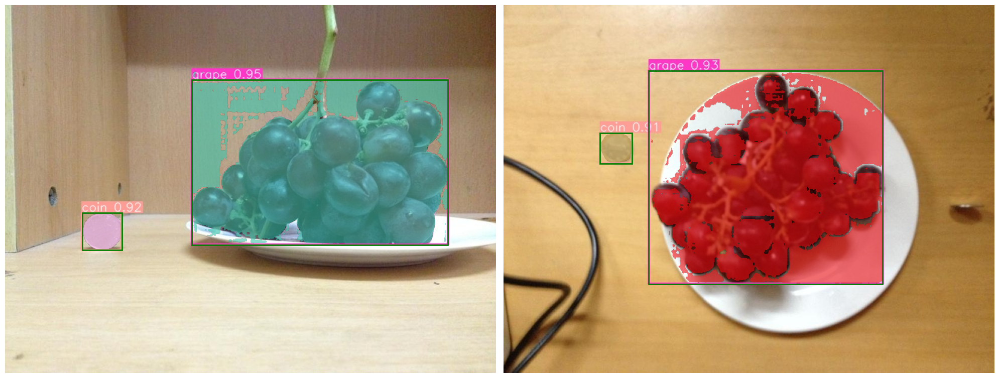

In [ ]:
img_s = pairs[35][0]
img_t = pairs[35][1]
side_masks,top_masks = get_mask_and_display(img_s,img_t,path_to_csv)

### accuracy check detectron

In [ ]:
pairs = get_pairs("/content/drive/MyDrive/test_results_aug")

output_objects (1).gsheet  is not top or side image
output_objects.csv  is not top or side image
output_objects2.csv  is not top or side image
output_objects.gsheet  is not top or side image
output_objects_detectron2.csv  is not top or side image


In [ ]:
path_to_csv = detectron_csv
csv_file_path = '/content/drive/MyDrive/sam/yolo.csv'
def organize_cls_and_area(pair):
  side_cls = get_cls(pair[0],path_to_csv)
  top_cls = get_cls(pair[1],path_to_csv)
  common_elements = set(side_cls) & set(top_cls)
  side_cls[:] = [elem for elem in side_cls if elem in common_elements]
  top_cls[:] = [elem for elem in top_cls if elem in common_elements]
  side_area = organize_area(pair[0],csv_file_path)
  top_area = organize_area(pair[1],csv_file_path)
  s = get_area_per_obj(side_cls,side_area)
  t = get_area_per_obj(top_cls,top_area)
  return merge_lists(s,t)

### increace accuracy

In [ ]:
pair = pairs[12]
img = pair[0]
pred_v = get_volume_from_for_all_objs_in_plate_with_mask(pair)
print(f"predict volume is {pred_v}")
print(f"real volume is {get_real_v(img)}")

predict volume is [['bread', 33.25088288573987]]
real volume is ['bread', 140]


In [ ]:
constant_num *= 140 / 33.25088288573987
def get_volume_from_mask(area_side,area_top,ratio_s,ratio_t):

  side = area_side * ratio_s
  top = area_top * ratio_t
  return (side * top)**(3/4) * constant_num # mm^3

In [ ]:
pair = pairs[0]
img = pair[0]
pred_v = get_volume_from_for_all_objs_in_plate_with_mask(pair)
print(f"predict volume is {pred_v}")
print(f"real volume is {get_real_v(img)}")

predict volume is [['apple', 1.9557331198059527]]
real volume is ['apple', 330]


In [ ]:
check_accuracy_mask()

-------images-------
/content/drive/MyDrive/test_results_aug/mix009S(1)-detectron2-result.jpg
/content/drive/MyDrive/test_results_aug/mix009T(1)-detectron2-result.jpg 

-------predict-------
lemon predict volume is 7.42453680852964 mm^3
lemon predict weight is 7.127555336188455 g

-------real-------:
lemon real volume is 100 mm^3
lemon real weight is 94.2 g

-------predict-------
orange predict volume is 140.67384097884633 mm^3
orange predict weight is 133.640148929904 g

-------real-------:
orange real volume is 270 mm^3
orange real weight is 232.5 g

-------error-------
volume error is 70.23702030335623 %
weight error is 67.47697955651263 %



In [ ]:
get_accuracy_in_all_dataset_mask()

{'apple': 99.31143356854624,
 'banana': 136.2031843055128,
 'bread': 70.07483942618953,
 'bun': 99.1663284527475,
 'doughnut': 93.55870243393358,
 'egg': 80.50806586915394,
 'fired_dough_twist': 91.15944678060654,
 'grape': 99.690830703848,
 'lemon': 94.2111425824125,
 'litchi': 69.88663401453276,
 'mango': 89.10701917911905,
 'mix': 83.90482689225365,
 'mooncake': 71.12174896304951,
 'orange': 99.01036290047887,
 'peach': 94.94728182354609,
 'pear': 95.64620202787512,
 'plum': 96.70405186431954,
 'qiwi': 89.50934540427478,
 'sachima': 93.6597039598672,
 'tomato': 90.76876136997464,
 'error of the data test': 91.5612352068874}

In [ ]:
error_summary_mask()

Highest error: banana
Value: 136.2031843055128 %

Lowest error: litchi
Value: 69.88663401453276 %

Mean error:
Value : 91.5612352068874 %


## weight estimation accuracy

Here we can see the accuracy summery of the weight estimation for each model:

**DETECTRON**:

**BBOX**:

Highest error: fired_dough_twist
Value: 152.59023162347077 %

Lowest error: litchi
Value: 13.686685355449045 %

Mean error:
Value : 38.84742222288313 %

**MASK**:

Highest error: banana
Value: 136.2031843055128 %

Lowest error: litchi
Value: 69.88663401453276 %

Mean error:
Value : 91.5612352068874 %

**YOLO**:

**BBOX**:

Highest error: fired_dough_twist
Value: 149.22698539220494 %

Lowest error: tomato
Value: 7.327299386286792 %

Mean error:
Value : 39.3166074575748 %

**MASK**:

Highest error: grape
Value: 208.47701910095915 %

Lowest error: apple
Value: 6.765247461789644 %

Mean error:
Value : 40.13226906157484 %

## Accuracy improvement

The accuracy of all models wasn't good enough, especially the progress to masks made the accuracy worse than the calculation based on the bounding box. We wanted to improve the accuracy.

Our strategy was to first use our results from YOLO and Detectrn2 saved in json format rather than CSV, which we realized was a lot more convenient to use. then, we ran the batched SAM inference again, and processed the output masks better, and saved all the masks to disk. we got better masks, and by using "Brute Force" we found "magic numbers" to predict the volume of each object.

Because the project is already very long and complicated, and also we ran out of time, we chose to implement only a proof of concept, and we didn't update each estimation (Detectron, Yolo, Sam-based Detectron, Sam-based Yolo).

Maybe we could have built a neural network to learn these magic numbers, but as stated, the project is too big as it is, and we haven't tried that option.

In the following chapter, we represent a better weight estimation based on a mask.

In hind sight, we realized that csv format is not very convenient for pulling results that are not strings, i.e. bboxes, scores, etc. so we will resave our test results in json format.

In [ ]:
input_images_directory = "/content/drive/MyDrive/dataset_augmented/test/"
test = []
for file in os.listdir(input_images_directory):
  if file[-3:] == "JPG":
    test.append(input_images_directory + file)

We wanted the test directory to be sorted to help us use the results easily.
Now we save Detectron2 results in json:

In [ ]:
json_dict =[]
output_path = "/content/drive/MyDrive/new_res/Detectron2_test_results/"
output_json_path = "/content/drive/MyDrive/new_res/Detectron2_test_results/Det2_Results.json"
out_file = open(output_json_path, "w")
test = sorted(test)
for file in test:
  new_im = cv2.imread(file)
  outputs = predictor(new_im)
  v = Visualizer(new_im[:, :, ::-1], metadata=test_metadata)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  class_labels = outputs["instances"].pred_classes.to("cpu").numpy()
  class_scores = outputs["instances"].scores.to("cpu").numpy()
  bounding_box = outputs["instances"].pred_boxes.tensor.numpy()
  with open("/content/drive/MyDrive/dataset_augmented/test/Test.json","r") as f:
      data = json.load(f)
  for im in data["images"]:
    if im["file_name"] == file.split("test/")[1]:
      idx = im["id"]
      break
  count = 0
  og_class_name = []
  class_pred = []
  bbox = []
  for im in data["annotations"]:
    if im["image_id"] == idx:
      og_class = im["category_id"]
      og_class_name.append(test_metadata.thing_classes[og_class])
      class_pred.append(test_metadata.thing_classes[class_labels[count]])
      bbox.append(bounding_box[count])
      count += 1
  tmp_bboxes = [[] for i in range(len(bbox))]
  for i in range(len(bbox)):
    for j in range(len(bbox[0])):
      tmp_bboxes[i].append(float(bbox[i][j]))
  new_name = file.split("test/")[1] + "-detectron2-result.jpg"
  json_dict.append({
      'image': file,
      'image_with_preds': output_path + new_name,
      'gt_class': og_class_name,
      'pred_class': class_pred,
      'scores': class_scores,
      'pred_box': tmp_bboxes
      })
  cv2.imwrite(output_path + new_name, out.get_image()[:, :, ::-1])
json.dump(json_dict, out_file, indent = 4)
out_file.close()

Now for YOLO:

In [ ]:
json_dict =[]
output_path = "/content/drive/MyDrive/new_res/YOLOv8_test_results/"
name = "100_epochs-test/"
output_json_path = output_path + name + "YOLOv8_Results.json"
test = sorted(test)

trained_model = YOLO("/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt")

results=(trained_model.predict(source = test,
                                      project=output_path,
                                      name=name,
                                      save=True,
                                      imgsz=640,
                                      conf=0.5))
for res in results:
  new_result = res
  detected_boxes = new_result.boxes.data
  class_labels = detected_boxes[:, -1].int().tolist()
  with open("/content/drive/MyDrive/dataset_augmented/test/Test.json","r") as f:
      data = json.load(f)
  for im in data["images"]:
    if im["file_name"] == res.path.split("/")[-1]:
      idx = im["id"]
      break
  count = 0
  og_class_name = []
  class_pred = []
  bbox = []
  class_names = list(new_result.names.values())
  for im in data["annotations"]:
    if im["image_id"] == idx:
      og_class = im["category_id"]
      og_class_name.append(class_names[og_class])
      class_pred.append(class_names[class_labels[count]])
      bbox.append(detected_boxes[count])
      count += 1
  tmp_bboxes = [[] for i in range(len(bbox))]
  for i in range(len(bbox)):
    for j in range(len(bbox[0])-1):
      tmp_bboxes[i].append(float(bbox[i][j]))

  result_filename = res.path.split("/")[-1] + "-YOLOv8-result.jpg"
  json_dict.append({
      'image': res.path,
      'image_with_preds': output_path + name + result_filename,
      'gt_class': og_class_name,
      'pred_class': class_pred,
      'scores':tmp_bboxes[:,4:]
      'pred_box': tmp_bboxes
      })
out_file = open(output_json_path, "w")
json.dump(json_dict, out_file, indent = 4)
out_file.close()


Now, we will use SAM and run it on our results:

In [ ]:
def sam_res_to_json(output_path, input_json, pairs_list,input_json_type):

  with open(input_json) as f:
    data = json.load(f)

  d = []

  start_time = time.time()

  for s,t in pairs_list:
      side = cv2.imread(s)
      side = cv2.cvtColor(side, cv2.COLOR_BGR2RGB)
      top = cv2.imread(t)
      top = cv2.cvtColor(top, cv2.COLOR_BGR2RGB)
      for file in data:
        if file["image"] == s:
          if input_json_type == 'detectron2':
            bbox_s = np.array(file["pred_box"])
          elif input_json_type =='yolo':
            bbox_s = bbox_s[:,:4]
          if len(bbox_s) == 2:
            s_boxes = torch.tensor([
            np.array(bbox_s[0]),
            np.array(bbox_s[1]),
        ], device=sam.device)
          else:
            s_boxes = torch.tensor([
            np.array(bbox_s[0]),
            np.array(bbox_s[1]),
            np.array(bbox_s[2]),
        ], device=sam.device)

        if file["image"] == t:
          if input_json_type == 'detectron2':
            bbox_t = np.array(file["pred_box"])
          elif input_json_type =='yolo':
            bbox_t = bbox_t[:,:4]
          bbox_t = np.array(file["pred_box"])
          if len(bbox_t) == 2:
            t_boxes = torch.tensor([
            np.array(bbox_t[0]),
            np.array(bbox_t[1]),
        ], device=sam.device)
          else:
            t_boxes = torch.tensor([
            np.array(bbox_t[0]),
            np.array(bbox_t[1]),
            np.array(bbox_t[2]),
        ], device=sam.device)

      batched_input = [
          {
              'image': prepare_image(side, resize_transform, sam),
              'boxes': resize_transform.apply_boxes_torch(s_boxes, side.shape[:2]),
              'original_size': side.shape[:2]
          },
          {
              'image': prepare_image(top, resize_transform, sam),
              'boxes': resize_transform.apply_boxes_torch(t_boxes, top.shape[:2]),
              'original_size': top.shape[:2]
          }
      ]

      batched_output = sam(batched_input, multimask_output=False)

      side_mask = np.array(batched_output[0]["masks"].cpu())
      top_mask = np.array(batched_output[1]["masks"].cpu())

      side_masks = []
      for i in range(len(bbox_s)):
        sm = side_mask[i].reshape(side.shape[0],side.shape[1])
        sm = sm.tolist()
        side_masks.append(sm)

      top_masks = []
      for i in range(len(bbox_t)):
        tm = top_mask[i].reshape(top.shape[0],top.shape[1])
        tm = tm.tolist()
        top_masks.append(tm)


      side_masks_area = [[] for _ in range(len(side_masks))]
      top_masks_area = [[] for _ in range(len(top_masks))]
      for i in range(len(side_masks)):
        side_masks_count = []
        for row in side_masks[i]:
          for mask in row:
            if mask!=False:
              side_masks_count.append(mask)
        side_masks_area[i] = len(side_masks_count)

      for i in range(len(top_masks)):
        top_masks_count = []
        for row in top_masks[i]:
          for mask in row:
            if mask!=False:
              top_masks_count.append(mask)
        top_masks_area[i] = len(top_masks_count)

      bbox_s = bbox_s.tolist()
      bbox_t = bbox_t.tolist()

      d.append({
          'image_side': s,
          'mask_side': side_masks,
          'mask_side_area': side_masks_area,
          'boxes_side':bbox_s,
          'image_top': t,
          'mask_top': top_masks,
          'mask_top_area': top_masks_area,
          'boxes_top':bbox_t,
      })

  with open(output_path,"w") as f:
    json.dump(d, f)

  end_time = time.time()

  execution_time = end_time - start_time

  print("Execution time:", execution_time, "seconds")

In [ ]:
sam_res_to_json("/content/drive/MyDrive/new_res/SAM/det2_res_sam.json", "/content/drive/MyDrive/new_res/Detectron2_test_results/Det2_Results.json", pairs,'detectron2')

In [ ]:
sam_res_to_json("/content/drive/MyDrive/new_res/SAM/yolo_res_sam.json", "/content/drive/MyDrive/new_res/YOLOv8_test_results/100_epochs-test/YOLOv8_Results.json", pairs,'yolo')

Let's see the masks, and compare between the two models masks, since the boundoing boxes can be different:

In [ ]:
with open("/content/drive/MyDrive/new_res/SAM/det2_res_sam.json") as f:
  det = json.load(f)

with open("/content/drive/MyDrive/new_res/SAM/yolo_res_sam.json") as f:
  yolo = json.load(f)

In [ ]:
for i,file in enumerate(det):
  for j,fil in enumerate(yolo):
    if i == j:
      # if i == 0:
      #   print("\nshowing bounding boxes and masks for class apple.\n")
      # if i%5==0 and i>0:
      #   print("\nshown ", i, " pairs already.\n")
      #   tmp = file["image_side"]
      #   tmp = tmp.split("test/")[1].split(".JPG")[0]
      #   print("\nshowing bounding boxes and masks for class ", tmp, ".\n")

      side_det = file["image_side"]
      top_det = file["image_top"]
      side_mask_det = file["mask_side"]
      top_mask_det = file["mask_top"]
      s_boxes_det = file["boxes_side"]
      t_boxes_det = file["boxes_top"]
      s_title_det = side_det.split("test/")[1].split(".JPG")[0]
      t_title_det = top_det.split("test/")[1].split(".JPG")[0]

      side_yolo = fil["image_side"]
      top_yolo = fil["image_top"]
      side_mask_yolo = fil["mask_side"]
      top_mask_yolo = fil["mask_top"]
      s_boxes_yolo = fil["boxes_side"]
      t_boxes_yolo = fil["boxes_top"]
      s_title_yolo = side_yolo.split("test/")[1].split(".JPG")[0]
      t_title_yolo = top_yolo.split("test/")[1].split(".JPG")[0]

      fig, ax = plt.subplots(nrows=1, ncols=4,figsize=(20,6))
      if i%5==0:
        tmp = file["image_side"]
        tmp = tmp.split("test/")[1].split("0")[0]
        plt.suptitle("\nshowing bounding boxes and masks for class " + tmp + ".\n")

      side = cv2.imread(side_det)
      side = cv2.cvtColor(side, cv2.COLOR_BGR2RGB)
      top = cv2.imread(top_det)
      top = cv2.cvtColor(top, cv2.COLOR_BGR2RGB)
      ax[0].imshow(side)
      for mask in side_mask_det:
        side_mask = np.array(mask)
        side_mask = side_mask.reshape(side.shape[0],side.shape[1])
        side_mask_tensor = torch.tensor(side_mask)
        show_mask(side_mask_tensor.cpu().numpy(), ax[0], random_color=True)
      for box in s_boxes_det:
          show_box(box, ax[0])
      ax[0].axis('off')
      ax[0].set_title(s_title_det + "-detectron2")
      ax[1].imshow(top)
      for mask in top_mask_det:
        top_mask = np.array(mask)
        top_mask = top_mask.reshape(top.shape[0],top.shape[1])
        top_mask_tensor = torch.tensor(top_mask)
        show_mask(top_mask_tensor.cpu().numpy(), ax[1], random_color=True)
      for box in t_boxes_det:
          show_box(box, ax[1])
      ax[1].axis('off')
      ax[1].set_title(t_title_det + "-detectron2")

      side = cv2.imread(side_yolo)
      side = cv2.cvtColor(side, cv2.COLOR_BGR2RGB)
      top = cv2.imread(top_yolo)
      top = cv2.cvtColor(top, cv2.COLOR_BGR2RGB)
      ax[2].imshow(side)
      for mask in side_mask_yolo:
        side_mask = np.array(mask)
        side_mask = side_mask.reshape(side.shape[0],side.shape[1])
        side_mask_tensor = torch.tensor(side_mask)
        show_mask(side_mask_tensor.cpu().numpy(), ax[2], random_color=True)
      for box in s_boxes_yolo:
          show_box(box, ax[2])
      ax[2].axis('off')
      ax[2].set_title(s_title_yolo + "-yolo")
      ax[3].imshow(top)
      for mask in top_mask_yolo:
        top_mask = np.array(mask)
        top_mask = top_mask.reshape(top.shape[0],top.shape[1])
        top_mask_tensor = torch.tensor(top_mask)
        show_mask(top_mask_tensor.cpu().numpy(), ax[3], random_color=True)
      for box in t_boxes_yolo:
          show_box(box, ax[3])
      ax[3].axis('off')
      ax[3].set_title(t_title_yolo + "-yolo")
      plt.tight_layout()
      plt.show()


We can see that SAM is a very robust model, giving us results with better masks than we expected - some bboxes don't bound the object as good as we would like, but the masks are perfect! we can also see that "grape" class mask were segmented perfectly this time.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
with open("/content/drive/MyDrive/new_res/YOLOv8_test_results/100_epochs-test/YOLOv8_Results.json") as f:
  data = json.load(f)
data[0]

{'image': '/content/drive/MyDrive/dataset_augmented/test/apple010S(1).JPG',
 'image_with_preds': '/content/drive/MyDrive/new_res/YOLOv8_test_results/100_epochs-test/apple010S(1).JPG-YOLOv8-result.jpg',
 'gt_class': ['apple', 'coin'],
 'pred_class': ['apple', 'coin'],
 'pred_box': [[433.01019287109375,
   174.5537567138672,
   669.8106079101562,
   402.2357177734375,
   0.9681687355041504],
  [126.6175765991211,
   354.3254699707031,
   201.8186492919922,
   428.98785400390625,
   0.922434389591217]]}

In [ ]:
with open("/content/drive/MyDrive/new_res/SAM/yolo_res_sam.json") as f:
  d = json.load(f)

In [ ]:
import os
from math import pi as pi
# constants
coin_radius_in_mm = 12.5
coin_diameter_in_mm = 25

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

In [ ]:
def get_dim_from_box(s_boxes,t_boxes,mask_side_area,mask_top_area):
  if mask_side_area[0] > mask_side_area[1]:
    s_width = abs(s_boxes[0][0]-s_boxes[0][2])
    s_height = abs(s_boxes[0][1]-s_boxes[0][3])
    s_coin_area = mask_side_area[1]
    s_coin_rad = (s_coin_area/pi)**0.5
    s_coin_width = s_coin_rad*2
  else:
    s_width = abs(s_boxes[1][0]-s_boxes[1][2])
    s_height = abs(s_boxes[1][1]-s_boxes[1][3])
    s_coin_area = mask_side_area[0]
    s_coin_rad = (s_coin_area/pi)**0.5
    s_coin_width = s_coin_rad*2
  if mask_top_area[0] > mask_top_area[1]:
    t_width = abs(t_boxes[0][0]-t_boxes[0][2])
    t_length = abs(t_boxes[0][1]-t_boxes[0][3])
    t_coin_area = mask_top_area[1]
    t_coin_rad = (t_coin_area/pi)**0.5
    t_coin_width = t_coin_rad*2
  else:
    t_width = abs(t_boxes[1][0]-t_boxes[1][2])
    t_length = abs(t_boxes[1][1]-t_boxes[1][3])
    t_coin_area = mask_top_area[0]
    t_coin_rad = (t_coin_area/pi)**0.5
    t_coin_width = t_coin_rad*2
  s_conv = s_width/s_coin_width
  t_conv = t_length/t_coin_width
  return s_width,s_height,s_coin_width,s_conv,t_width,t_length,t_coin_width,t_conv

In [ ]:
def get_radius_conv(mask_side_area,mask_top_area):
  if len(mask_side_area) == 2:
    if mask_side_area[0] > mask_side_area[1]:
      s_obj1_area = mask_side_area[0]
      s_coin_area = mask_side_area[1]
    else:
      s_obj1_area = mask_side_area[1]
      s_coin_area = mask_side_area[0]
    if mask_top_area[0] > mask_top_area[1]:
      t_obj1_area = mask_top_area[0]
      t_coin_area = mask_top_area[1]
    else:
      t_obj1_area = mask_top_area[1]
      t_coin_area = mask_top_area[0]
  else: #mix class
    min_index = mask_side_area.index(min(mask_side_area))
    max_index = mask_side_area.index(max(mask_side_area))
    for i in range(len(mask_side_area)):
      if i != max_index and i != min_index:
        s_obj2_area = mask_side_area[i]
    s_obj1_area = mask_side_area[max_index]
    s_coin_area = mask_side_area[min_index]

    min_index = mask_top_area.index(min(mask_top_area))
    max_index = mask_top_area.index(max(mask_top_area))
    for i in range(len(mask_top_area)):
      if i != max_index and i != min_index:
        t_obj2_area = mask_top_area[i]
    t_obj1_area = mask_top_area[max_index]
    t_coin_area = mask_top_area[min_index]


  s_obj_rad = (s_obj1_area/pi)**0.5
  s_coin_rad = (s_coin_area/pi)**0.5
  s_conv = s_obj_rad/s_coin_rad
  t_obj_rad = (t_obj1_area/pi)**0.5
  t_coin_rad = (t_coin_area/pi)**0.5
  t_conv = t_obj_rad/t_coin_rad
  return s_conv, t_conv

In [ ]:
import os
input_images_directory = "/content/drive/MyDrive/dataset_augmented/test/"
test = []
for file in os.listdir(input_images_directory):
  if file[-3:] == "JPG":
    test.append(input_images_directory + file)

test_s = []
test_t = []
for file in test:
  if ("T(") in file:
    test_t.append(file)
  else:
    test_s.append(file)

pairs = list(zip(sorted(test_s),sorted(test_t)))
print(len(pairs))

In [ ]:
def extract_filename(path):
    filename = os.path.splitext(os.path.basename(path))[0]
    stop_index = max(filename.find('S'), filename.find('T')) if 'S' in filename or 'T' in filename else -1
    if stop_index != -1:
        filename = filename[:stop_index]
    return filename

In [ ]:
def get_real_w_v(obj):
  obj = extract_filename(obj)
  return w_v_df.loc[w_v_df['id'].isin([obj])]

In [ ]:
import pandas as pd
w_v_df = pd.read_excel(
    "/content/ECUSTFD-resized-/density.xls",
    sheet_name=None,
)
w_v_df = pd.concat(w_v_df.values(), axis=0)
w_v_df = w_v_df.reset_index(drop=True)
w_v_df

,id,type,volume(mm^3),weight(g)
0,apple001,apple,310,244.5
1,apple002,apple,290,232.5
2,apple003,apple,280,219.0
3,apple004,apple,300,234.0
4,apple005,apple,280,212.5
...,...,...,...,...
169,sachima005,sachima,150,32.7
170,tomato001,tomato,210,214.5
171,tomato002,tomato,190,154.2
172,tomato003,tomato,180,186.4


In [ ]:
side = []
top = []
for i in range(200):
  # print(data[i]["image"].split("(")[0])
  if (data[i]["image"].split("(")[0])[-1] == 'S':
    side.append(data[i])
  if (data[i]["image"].split("(")[0])[-1] == 'T':
    top.append(data[i])
pairss = list(zip(side,top))

bad volume prediction in: banana004S(1).JPG
pred class: banana
pred volume: 325.4675525838216
real volume: 200


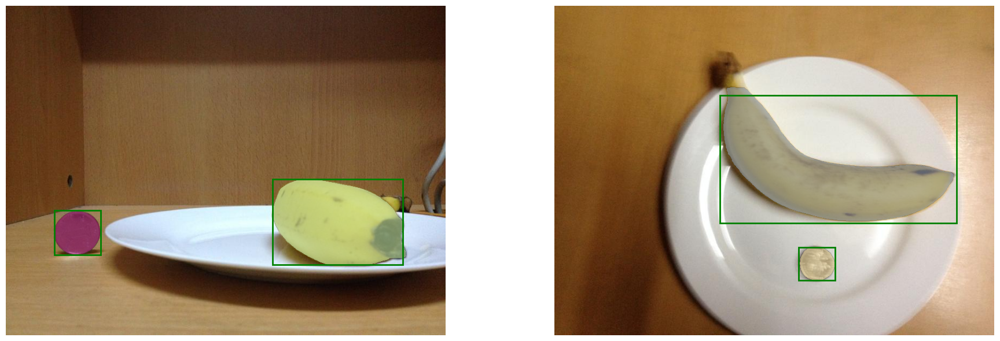

bad volume prediction in: banana007S(1).JPG
pred class: banana
pred volume: 216.71980568169488
real volume: 150


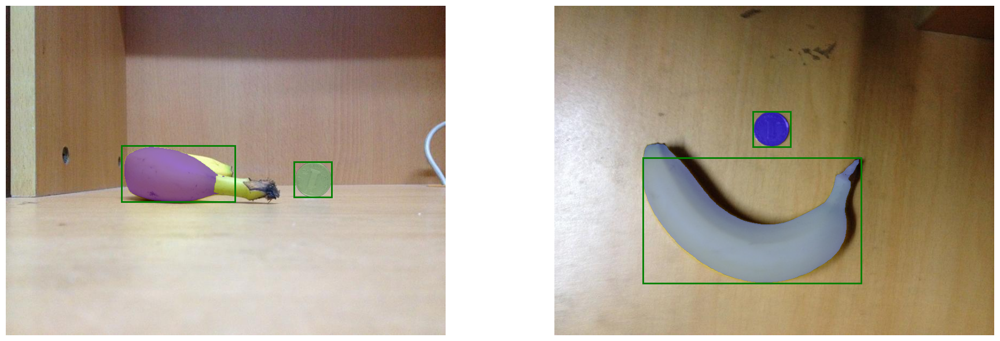

bad volume prediction in: banana013S(10).JPG
pred class: banana
pred volume: 121.0316787109375
real volume: 190


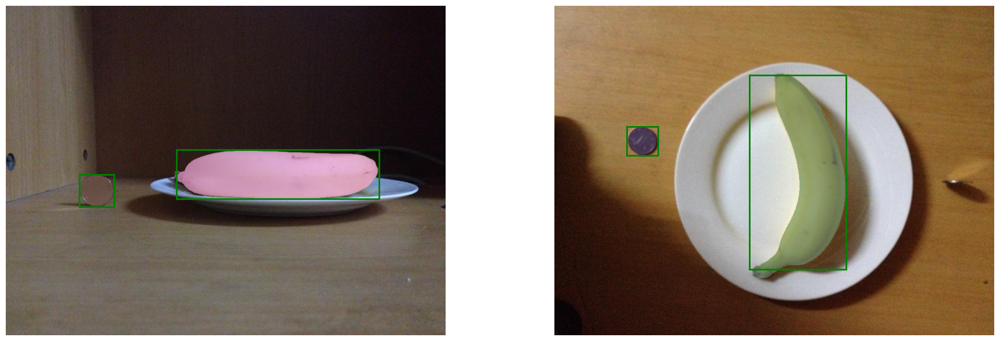

bad volume prediction in: bread001S(7).JPG
pred class: bread
pred volume: 177.27404559692383
real volume: 140


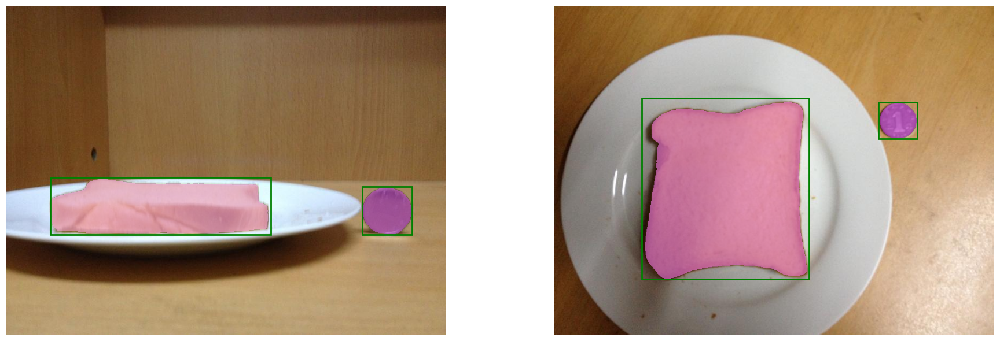

bad volume prediction in: bread004S(1).JPG
pred class: bread
pred volume: 126.01028819458008
real volume: 170


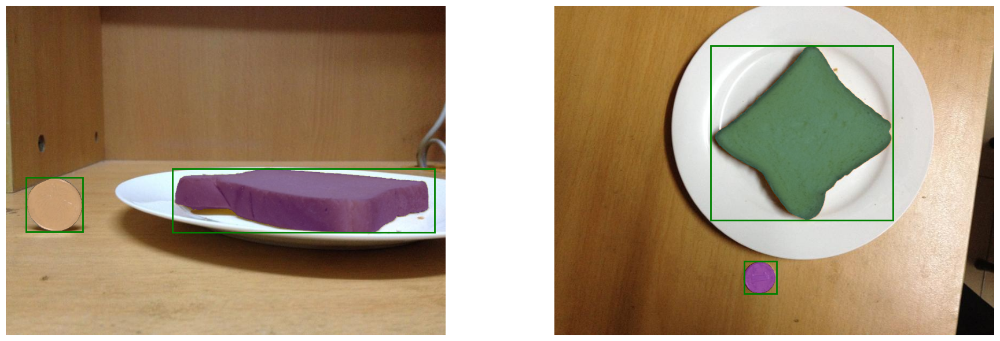

bad volume prediction in: doughnut002S(3).JPG
pred class: doughnut
pred volume: 340.3977061010742
real volume: 220


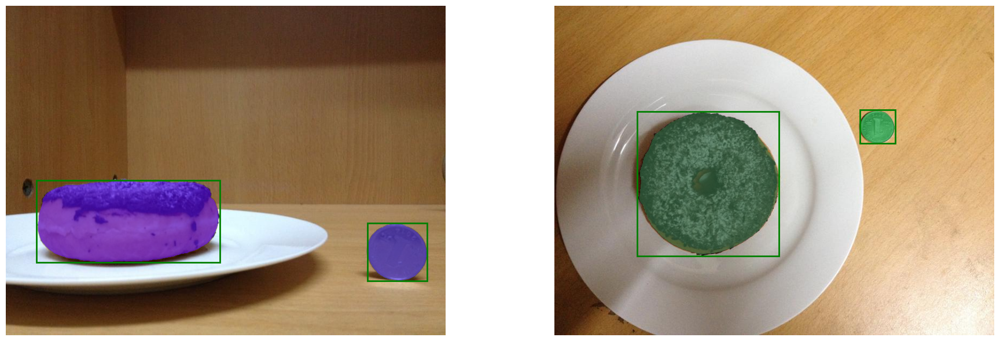

bad volume prediction in: fired_dough_twist004S(10).JPG
pred class: fired_dough_twist
pred volume: 75.79197030552456
real volume: 60


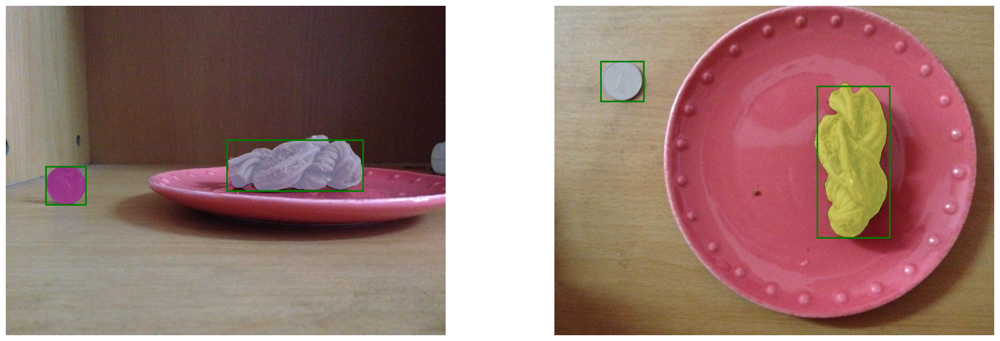

bad volume prediction in: fired_dough_twist007S(1).JPG
pred class: fired_dough_twist
pred volume: 13.539572610037668
real volume: 60


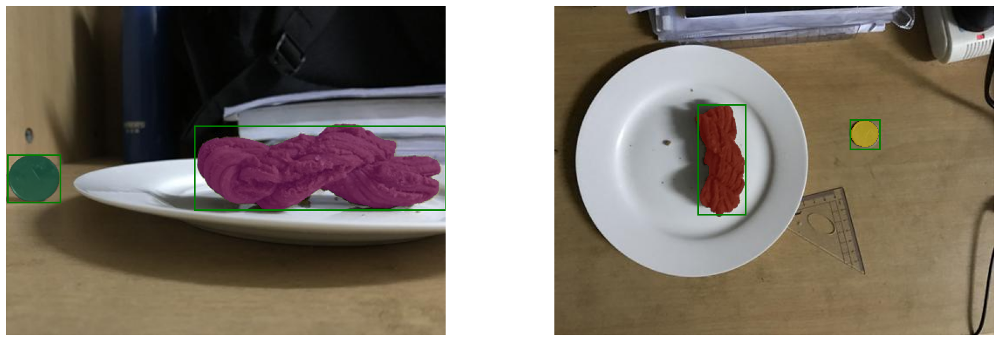

bad volume prediction in: mango005S(9).JPG
pred class: mango
pred volume: 66.38923628969495
real volume: 50


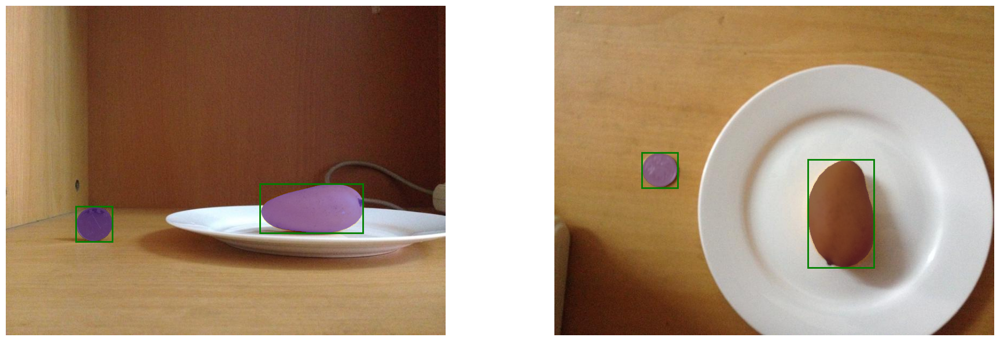

bad volume prediction in: mango007S(3).JPG
pred class: mango
pred volume: 66.5103795805262
real volume: 50


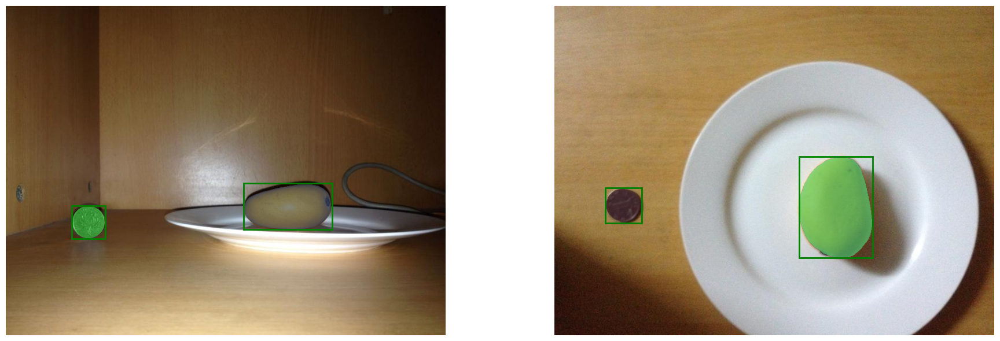

bad volume prediction in: mix007S(3).JPG
pred class: mango
pred volume: 91.25460727581373
real volume: 200


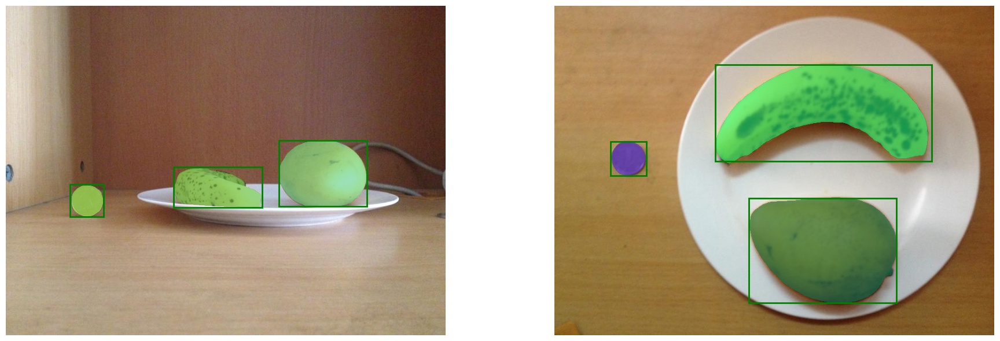

bad volume prediction in: mix007S(3).JPG
pred class: banana
pred volume: 233.8129028157552
real volume: 140


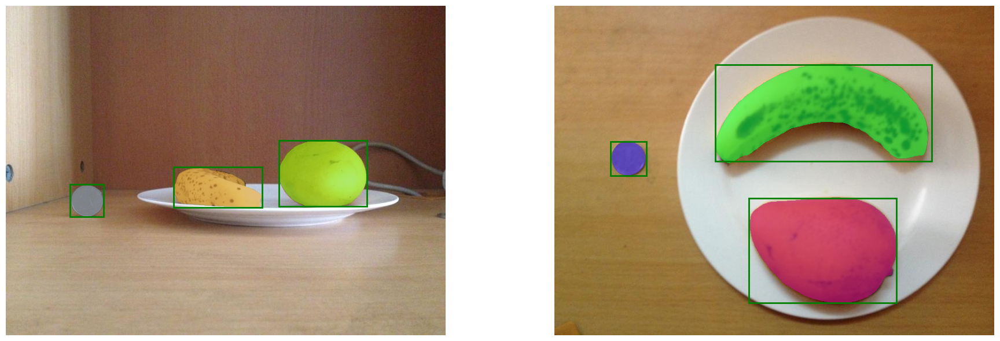

bad volume prediction in: mix009S(1).JPG
pred class: orange
pred volume: 214.6652841656299
real volume: 270


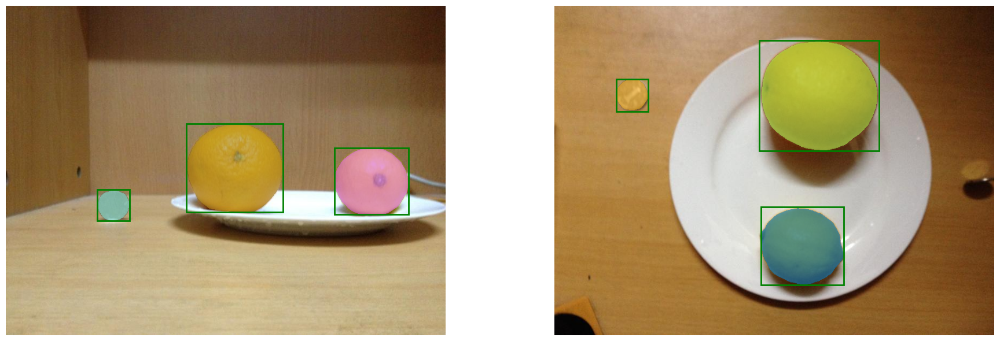

bad volume prediction in: mix013S(4).JPG
pred class: lemon
pred volume: 124.05965044367127
real volume: 100


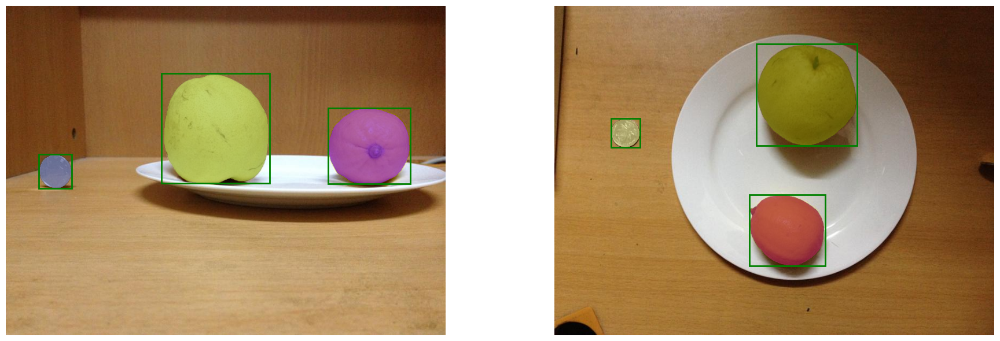

bad volume prediction in: orange001S(2).JPG
pred class: orange
pred volume: 213.75058113589557
real volume: 160


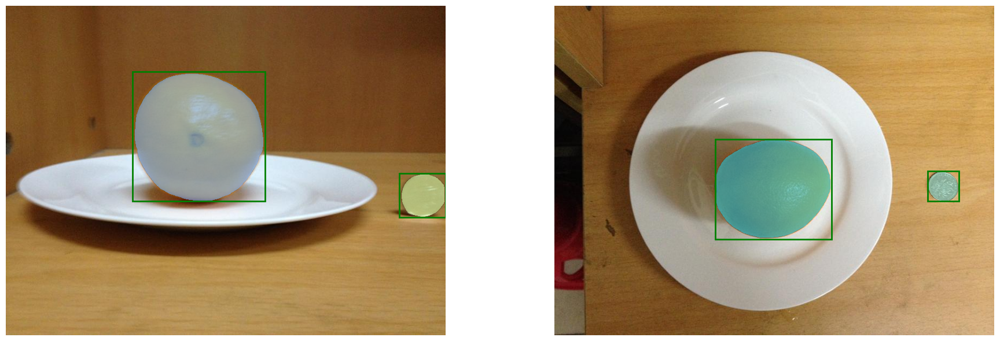

bad volume prediction in: qiwi005S(7).JPG
pred class: qiwi
pred volume: 147.09588283786726
real volume: 190


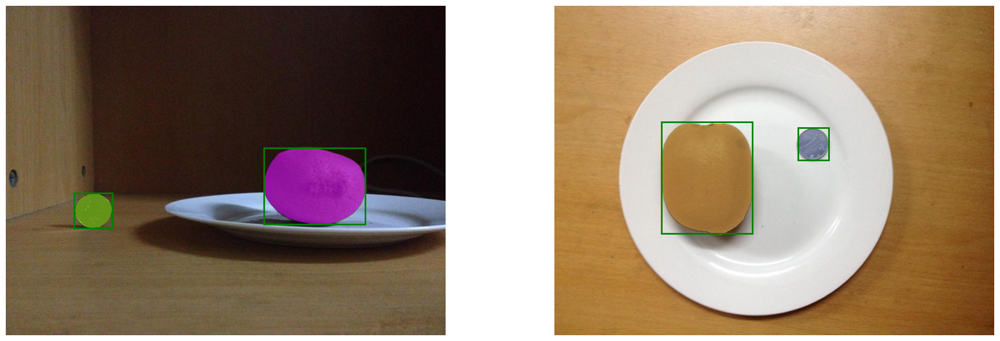

bad volume prediction in: qiwi008S(1).JPG
pred class: qiwi
pred volume: 88.14906719790045
real volume: 50


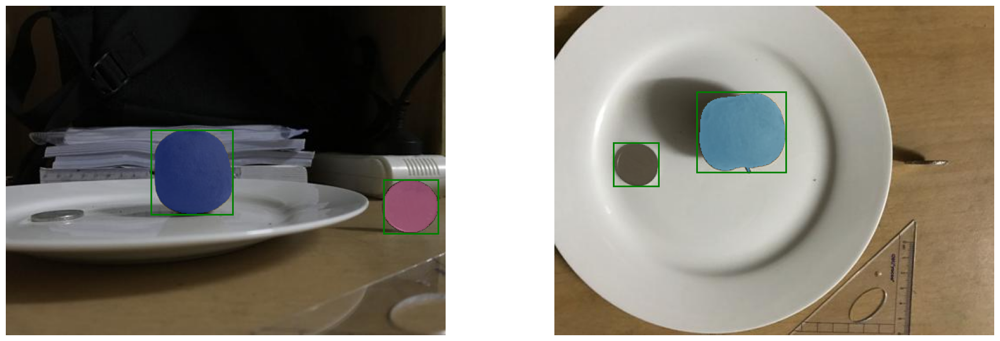

In [ ]:
names = []
pred_cls = []
pred_list = []
real_list = []
for index,file in enumerate(d):
  for p in pairss:
    obj = []
    if p[0]["image"] == file["image_side"]:
      for j in range(len(p[0]["pred_class"])):
        if p[0]["pred_class"][j] != 'coin':
          obj.append(p[0]["pred_class"][j])
      for k in range(len(obj)):
          mask_side_area = file["mask_side_area"]
          mask_top_area = file["mask_top_area"]
          mask_side = file["mask_side"]
          mask_top = file["mask_top"]
          s_boxes = file["boxes_side"]
          t_boxes = file["boxes_top"]
          side_name = file["image_side"]
          top_name = file["image_top"]
          if len(obj) == 2:#class mix
            min_index = mask_side_area.index(min(mask_side_area))
            max_index = mask_side_area.index(max(mask_side_area))
            s_big = []
            s_big.append(mask_side_area[max_index])
            s_big.append(mask_side_area[min_index])
            s_med = []
            for i in range(len(mask_side_area)):
              if i != max_index and i != min_index:
                s_med.append(mask_side_area[i])
            s_med.append(mask_side_area[min_index])
            min_index = mask_top_area.index(min(mask_top_area))
            max_index = mask_top_area.index(max(mask_top_area))
            t_big = []
            t_big.append(mask_top_area[max_index])
            t_big.append(mask_top_area[min_index])
            t_med = []
            for i in range(len(mask_top_area)):
              if i != max_index and i != min_index:
                t_med.append(mask_top_area[i])
            t_med.append(mask_top_area[min_index])
            if s_big[0] > s_med[0]:
              s,t = get_radius_conv(s_big,t_big)
            else:
              s,t = get_radius_conv(s_med,t_med)
          else: # one object
            s,t = get_radius_conv(mask_side_area,mask_top_area)
          s_width,s_height,s_coin_width,s_conv,t_width,t_length,t_coin_width,t_conv = (get_dim_from_box(s_boxes,t_boxes,mask_side_area,mask_top_area))

          #the magic number we divide with were found by averaging the difference between the pred result and the gt
          if obj[k] == 'banana':
            pred_volume = max(mask_top_area)*s_height/22500
          if obj[k] == 'fired_dough_twist':
            pred_volume = max(mask_top_area)*s_height/35000
          if obj[k] == 'bread':
            pred_volume = max(mask_top_area)*s_height/50000
          if obj[k] == 'sachima':
            pred_volume = max(mask_top_area)*s_height/22500
          if obj[k] == 'mooncake':
            pred_volume = max(mask_top_area)*s_height/22500
          if obj[k] == 'doughnut':
            pred_volume = max(mask_top_area)*s_height/25000 + 20
          if obj[k] == 'grape':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/2.5
          if obj[k] == 'apple':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/2
          if obj[k] == 'tomato':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/3
          if obj[k] == 'litchi':
            pred_volume = 0.01*pi*(4/3)*(s/t*coin_radius_in_mm**3)/2
          if obj[k] == 'pear':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/2.25
          if obj[k] == 'plum':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/3.5
          if obj[k] == 'orange':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/(2.5)
          if obj[k] == 'peach':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/4
          if obj[k] == 'egg':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/6.5
          if obj[k] == 'lemon':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/4.5
          if obj[k] == 'qiwi':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/3.25
          if obj[k] == 'mango':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/5.5
          if obj[k] == 'bun':
            pred_volume = (0.01*pi*(4/3)*(s*coin_radius_in_mm**3)+0.01*pi*(4/3)*(t*coin_radius_in_mm**3))/2.25

          to_check = p[0]["image"].split("test/")[1].split("(")[0][:-1]
          if p[0]["image"].split("test/")[1].split("0")[0] == 'mix':
            if get_real_w_v(to_check)["type"].iloc[0] == obj[k]:
              real_volume = get_real_w_v(to_check)["volume(mm^3)"].iloc[0]
            else:
              real_volume = get_real_w_v(to_check)["volume(mm^3)"].iloc[1]
            if pred_volume/real_volume >1.2 or pred_volume/real_volume < 0.8:
              print("bad volume prediction in:" ,side_name.split("test/")[1])
              print("pred class:", obj[k])
              print("pred volume:" , pred_volume)
              print("real volume:",real_volume)
              fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(20,6))
              side = cv2.imread(side_name)
              side = cv2.cvtColor(side, cv2.COLOR_BGR2RGB)
              top = cv2.imread(top_name)
              top = cv2.cvtColor(top, cv2.COLOR_BGR2RGB)
              ax[0].imshow(side)
              for mask in mask_side:
                side_mask = np.array(mask)
                side_mask = side_mask.reshape(side.shape[0],side.shape[1])
                side_mask_tensor = torch.tensor(side_mask)
                show_mask(side_mask_tensor.cpu().numpy(), ax[0], random_color=True)
              for box in s_boxes:
                  show_box(box, ax[0])
              ax[0].axis('off')
              ax[1].imshow(top)
              for mask in mask_top:
                top_mask = np.array(mask)
                top_mask = top_mask.reshape(top.shape[0],top.shape[1])
                top_mask_tensor = torch.tensor(top_mask)
                show_mask(top_mask_tensor.cpu().numpy(), ax[1], random_color=True)
              for box in t_boxes:
                  show_box(box, ax[1])
              ax[1].axis('off')
              plt.tight_layout()
              plt.show()
          else:
            real_volume = get_real_w_v(to_check)["volume(mm^3)"].iloc[0]
            if pred_volume/real_volume >1.2 or pred_volume/real_volume < 0.8:
              print("bad volume prediction in:" ,side_name.split("test/")[1])
              print("pred class:", obj[k])
              print("pred volume:" , pred_volume)
              print("real volume:",real_volume)
              fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(20,6))
              side = cv2.imread(side_name)
              side = cv2.cvtColor(side, cv2.COLOR_BGR2RGB)
              top = cv2.imread(top_name)
              top = cv2.cvtColor(top, cv2.COLOR_BGR2RGB)
              ax[0].imshow(side)
              for mask in mask_side:
                side_mask = np.array(mask)
                side_mask = side_mask.reshape(side.shape[0],side.shape[1])
                side_mask_tensor = torch.tensor(side_mask)
                show_mask(side_mask_tensor.cpu().numpy(), ax[0], random_color=True)
              for box in s_boxes:
                  show_box(box, ax[0])
              ax[0].axis('off')
              ax[1].imshow(top)
              for mask in mask_top:
                top_mask = np.array(mask)
                top_mask = top_mask.reshape(top.shape[0],top.shape[1])
                top_mask_tensor = torch.tensor(top_mask)
                show_mask(top_mask_tensor.cpu().numpy(), ax[1], random_color=True)
              for box in t_boxes:
                  show_box(box, ax[1])
              ax[1].axis('off')
              plt.tight_layout()
              plt.show()
          names.append(to_check)
          pred_cls.append(obj[k])
          pred_list.append(pred_volume)
          real_list.append(real_volume)
pred_real = list(zip(names,pred_cls,pred_list,real_list))

In [ ]:
for row in pred_real:
  accuarcy = row[2]/row[3]
  print(row)
  if abs(accuarcy-1)*100 > 20:
    print("bad prediction with",row[0])
  print("deviation from real volume is:", abs(accuarcy-1)*100,"%\n")


('apple010', 'apple', 296.3147027240898, 330)
deviation from real volume is: 10.207665841184909 %

('apple014', 'apple', 274.91334320161025, 290)
deviation from real volume is: 5.202295447720607 %

('apple016', 'apple', 288.4225945717673, 330)
deviation from real volume is: 12.599213766131111 %

('apple017', 'apple', 297.25000304079015, 330)
deviation from real volume is: 9.924241502790865 %

('apple018', 'apple', 287.3335663564686, 290)
deviation from real volume is: 0.9194598770797868 %

('banana004', 'banana', 325.4675525838216, 200)
bad prediction with banana004
deviation from real volume is: 62.73377629191079 %

('banana007', 'banana', 216.71980568169488, 150)
bad prediction with banana007
deviation from real volume is: 44.479870454463246 %

('banana010', 'banana', 168.45805164794922, 190)
deviation from real volume is: 11.337867553710934 %

('banana011', 'banana', 145.37078661024304, 130)
deviation from real volume is: 11.823682007879267 %

('banana013', 'banana', 121.03167871093